In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [5]:
denuncias = pd.read_csv("../data/processed/denuncias.csv")
establecimientos = pd.read_csv("../data/processed/establecimientos.csv")
matriculas = pd.read_csv("../data/processed/matriculas.csv")
sep_ee = pd.read_csv("../data/processed/sep_establecimientos.csv")
comunas_geo = gpd.read_file("../data/raw/comunas/comunas.shp")

In [6]:
establecimientos["longitud"] = establecimientos["longitud"].replace(0, pd.NA)
establecimientos["latitud"] = establecimientos["latitud"].replace(0, pd.NA)
establecimientos["longitud"] = pd.to_numeric(establecimientos["longitud"])
establecimientos["latitud"] = pd.to_numeric(establecimientos["latitud"])

In [7]:
latest_data = establecimientos.sort_values("agno").groupby("rbd").last().reset_index()

In [44]:
latest_data["rbd"].nunique()

16698

In [8]:
gdf_establecimientos = gpd.GeoDataFrame(
    latest_data.dropna(subset=["longitud", "latitud"]),
    geometry=gpd.points_from_xy(
        latest_data.dropna(subset=["longitud", "latitud"])["longitud"],
        latest_data.dropna(subset=["longitud", "latitud"])["latitud"],
    ),
    crs="EPSG:4326",
)

In [54]:
totaldenuncias_rbd = (
    denuncias.groupby(["rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index()
)

In [26]:
gdf_establecimientos: gpd.GeoDataFrame = gdf_establecimientos.merge(
    denuncias.groupby(["rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index(),
    on="rbd",
)

In [27]:
gdf_establecimientos.head(2)

,rbd,Unnamed: 0,agno,nom_rbd,cod_reg_rbd,cod_com_rbd,nom_com_rbd,cod_depe,cod_depe2,rural_rbd,latitud,longitud,convenio_pie,ori_religiosa,pago_matricula,pago_mensual,geometry,total_denuncias
0,1,141766,2023,LICEO POLITECNICO ARICA,15,15101,ARICA,6,5,0,-18.487200,-70.295212,1,2,1,1,POINT (-70.29521 -18.4872),24
1,2,141767,2023,PARVULARIO LAS ESPIGUITAS,15,15101,ARICA,6,5,0,-18.469862,-70.302757,1,2,1,1,POINT (-70.30276 -18.46986),2


In [43]:
gdf_establecimientos["rbd"].nunique()

9539

In [49]:
gdf_establecimientos.explore()

In [42]:
import folium

n = folium.Map(location=[-33.45, -70.64], tiles="OpenStreetMap", zoom_start=10)

for ee in gdf_establecimientos.itertuples():
    folium.CircleMarker(
        location=[ee.latitud, ee.longitud],
        popup=(ee.nom_rbd, ee.total_denuncias),
        radius=float(ee.total_denuncias) * 0.07,
        opacity=0.7,
        stroke=False,
        fill=True,
        fill_color="red",
    ).add_to(n)

# A title can be added to the map, if desired.
n.get_root().html.add_child(folium.Element("<h3 align='center'>Denuncias</h3>"))

n

In [48]:
comunas_geo[comunas_geo["Comuna"] == "Arica"].head(2)

,objectid,shape_leng,dis_elec,cir_sena,cod_comuna,codregion,st_area_sh,st_length_,Region,Comuna,Provincia,geometry
223,157,341130.036414,1,1,15101,15,5.370647e+09,386953.254435,Región de Arica y Parinacota,Arica,Arica,"POLYGON ((-7832403.57 -2130553.365, -7832398.1..."


In [47]:
establecimientos.head()

,Unnamed: 0,agno,rbd,nom_rbd,cod_reg_rbd,cod_com_rbd,nom_com_rbd,cod_depe,cod_depe2,rural_rbd,latitud,longitud,convenio_pie,ori_religiosa,pago_matricula,pago_mensual
0,0,2014,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,-18.487274,-70.294739,1,2,1,1
1,1,2014,2,PARVULARIO LAS ESPIGUITAS,15,15101,ARICA,2,1,0,-18.469862,-70.302757,1,2,1,1
2,2,2014,3,ESC. PEDRO VICENTE GUTIERREZ TORRES,15,15101,ARICA,2,1,1,-18.503580,-70.260826,0,2,1,1
3,3,2014,4,LICEO OCTAVIO PALMA PEREZ,15,15101,ARICA,2,1,0,-18.474243,-70.308266,1,1,1,1
4,4,2014,5,JOVINA NARANJO FERNANDEZ,15,15101,ARICA,2,1,0,-18.476904,-70.313454,1,7,1,1


# Establecimientos por comunas

<Axes: xlabel='agno'>

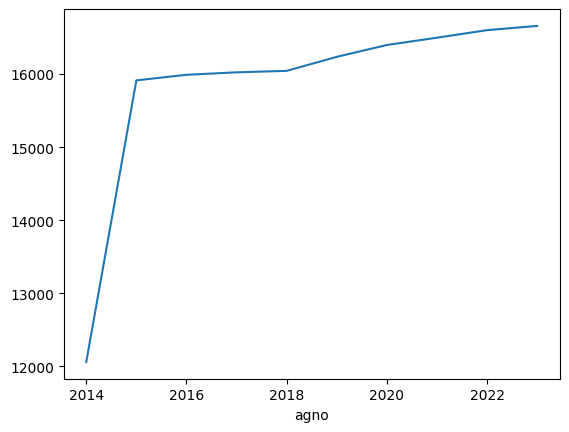

In [53]:
sns.lineplot(
    establecimientos.groupby("agno").size(),
)

<Axes: xlabel='agno'>

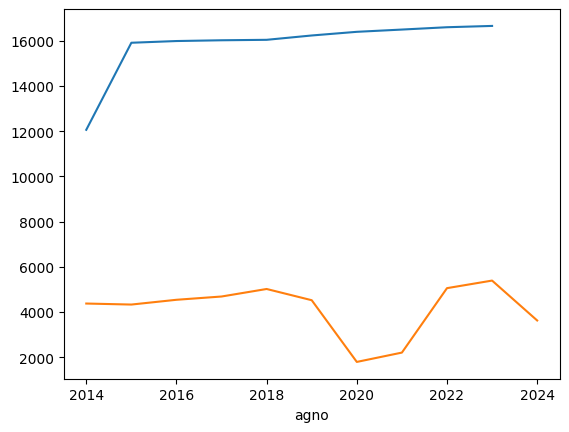

In [58]:
sns.lineplot(
    establecimientos.groupby("agno").size(),
)
sns.lineplot(
    denuncias.groupby(["agno", "rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index()
    .groupby("agno")
    .size()
)

## Dataset agrupado por año y comuna, con nº de denuncias nº de matriculas  nº de establecimientos

In [72]:
display(denuncias.info())
display(matriculas.info())
display(establecimientos.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121768 entries, 0 to 121767
Data columns (total 13 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Unnamed: 0                121768 non-null  int64  
 1   agno                      121768 non-null  int64  
 2   den_canal                 121768 non-null  int64  
 3   den_estado                121768 non-null  int64  
 4   den_fec_creacion          121768 non-null  object 
 5   den_fec_termino_denuncia  116098 non-null  object 
 6   den_oficina               121768 non-null  int64  
 7   den_departamento          121768 non-null  int64  
 8   den_ambito                121768 non-null  object 
 9   den_tema                  121768 non-null  object 
 10  den_subtema               121768 non-null  object 
 11  den_sexo                  121768 non-null  int64  
 12  rbd                       116472 non-null  float64
dtypes: float64(1), int64(7), object(5)
memory us

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158425 entries, 0 to 158424
Data columns (total 23 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Unnamed: 0   158425 non-null  int64 
 1   agno         158425 non-null  int64 
 2   rbd          158425 non-null  int64 
 3   nom_rbd      158185 non-null  object
 4   mat_hom_1    158425 non-null  int64 
 5   mat_muj_1    158425 non-null  int64 
 6   mat_hom_2    158425 non-null  int64 
 7   mat_muj_2    158425 non-null  int64 
 8   mat_hom_3    158425 non-null  int64 
 9   mat_muj_3    158425 non-null  int64 
 10  mat_hom_4    158425 non-null  int64 
 11  mat_muj_4    158425 non-null  int64 
 12  mat_hom_5    158425 non-null  int64 
 13  mat_muj_5    158425 non-null  int64 
 14  mat_hom_6    158425 non-null  int64 
 15  mat_muj_6    158425 non-null  int64 
 16  mat_hom_7    158425 non-null  int64 
 17  mat_muj_7    158425 non-null  int64 
 18  mat_hom_8    158425 non-null  int64 
 19  ma

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158425 entries, 0 to 158424
Data columns (total 16 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Unnamed: 0      158425 non-null  int64  
 1   agno            158425 non-null  int64  
 2   rbd             158425 non-null  int64  
 3   nom_rbd         158155 non-null  object 
 4   cod_reg_rbd     158425 non-null  int64  
 5   cod_com_rbd     158425 non-null  int64  
 6   nom_com_rbd     158425 non-null  object 
 7   cod_depe        158425 non-null  int64  
 8   cod_depe2       158425 non-null  int64  
 9   rural_rbd       158425 non-null  int64  
 10  latitud         128468 non-null  float64
 11  longitud        128468 non-null  float64
 12  convenio_pie    158425 non-null  int64  
 13  ori_religiosa   158425 non-null  int64  
 14  pago_matricula  158425 non-null  int64  
 15  pago_mensual    158425 non-null  int64  
dtypes: float64(2), int64(12), object(2)
memory usage: 19.3+ 

None

In [203]:
denuncias_agno_rbd = (
    denuncias.groupby(["agno", "rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index()
)

denuncias_matriculas_agno_rbd = pd.merge(
    matriculas, denuncias_agno_rbd, on=["agno", "rbd"], how="left"
)

denuncias_matriculas_agno_rbd["total_denuncias"] = (
    denuncias_matriculas_agno_rbd["total_denuncias"].fillna(0).astype(int)
)


estab_denun_matr_agno_rbd = establecimientos.merge(
    denuncias_matriculas_agno_rbd, on=["agno", "rbd"], how="left"
)

estab_denun_matr_agno_rbd[["total_denuncias", "mat_total"]] = (
    estab_denun_matr_agno_rbd[["total_denuncias", "mat_total"]].fillna(0).astype(int)
)

In [204]:
establecimientos.groupby(["agno", "cod_com_rbd"]).agg({"rbd": "count"}).rename(
    columns={"rbd": "total_establecimientos"}
).reset_index()

,agno,cod_com_rbd,total_establecimientos
0,2014,1101,127
1,2014,1107,51
2,2014,1401,12
3,2014,1402,10
4,2014,1403,5
...,...,...,...
3455,2023,16301,69
3456,2023,16302,40
3457,2023,16303,25
3458,2023,16304,10


In [205]:
estab_denun_matr_agno_rbd.columns

Index(['Unnamed: 0_x', 'agno', 'rbd', 'nom_rbd_x', 'cod_reg_rbd',
       'cod_com_rbd', 'nom_com_rbd', 'cod_depe', 'cod_depe2', 'rural_rbd',
       'latitud', 'longitud', 'convenio_pie', 'ori_religiosa',
       'pago_matricula', 'pago_mensual', 'Unnamed: 0_y', 'nom_rbd_y',
       'mat_hom_1', 'mat_muj_1', 'mat_hom_2', 'mat_muj_2', 'mat_hom_3',
       'mat_muj_3', 'mat_hom_4', 'mat_muj_4', 'mat_hom_5', 'mat_muj_5',
       'mat_hom_6', 'mat_muj_6', 'mat_hom_7', 'mat_muj_7', 'mat_hom_8',
       'mat_muj_8', 'mat_hom_tot', 'mat_muj_tot', 'mat_total',
       'total_denuncias'],
      dtype='object')

In [206]:
estab_denun_matr_agno_comun = (
    estab_denun_matr_agno_rbd.groupby(["agno", "cod_com_rbd", "nom_com_rbd"])
    .agg(
        {"rbd": "count", "total_denuncias": "sum", "mat_total": "sum"},
    )
    .rename(
        columns={"rbd": "total_establecimientos"},
    )
    .reset_index()
)

In [207]:
estab_denun_matr_agno_comun

,agno,cod_com_rbd,nom_com_rbd,total_establecimientos,total_denuncias,mat_total
0,2014,1101,IQUIQUE,127,330,42725
1,2014,1107,ALTO HOSPICIO,51,232,26542
2,2014,1401,POZO ALMONTE,12,5,2935
3,2014,1402,CAMINA,10,0,245
4,2014,1403,COLCHANE,5,2,154
...,...,...,...,...,...,...
3455,2023,16301,SAN CARLOS,69,27,10856
3456,2023,16302,COIHUECO,40,17,4846
3457,2023,16303,ÑIQUÉN,25,4,1770
3458,2023,16304,SAN FABIÁN,10,1,976


In [208]:
matriculas[matriculas["agno"] == 2023]["mat_total"].sum()

np.int64(3631067)

In [209]:
estab_denun_matr_agno_comun["cod_com_rbd"] = (
    estab_denun_matr_agno_comun["cod_com_rbd"].astype(int).astype(str)
)
comunas_geo["cod_comuna"] = comunas_geo["cod_comuna"].astype(int).astype(str)

In [210]:
estab_denun_mat_geo = estab_denun_matr_agno_comun.merge(
    comunas_geo,
    left_on="cod_com_rbd",
    right_on="cod_comuna",
    how="left",
)

In [211]:
display(comunas_geo.info())
display(estab_denun_matr_agno_comun.info())
display(estab_denun_mat_geo.info())

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 346 entries, 0 to 345
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   objectid    346 non-null    int64   
 1   shape_leng  346 non-null    float64 
 2   dis_elec    346 non-null    int32   
 3   cir_sena    346 non-null    int32   
 4   cod_comuna  346 non-null    object  
 5   codregion   346 non-null    int32   
 6   st_area_sh  346 non-null    float64 
 7   st_length_  346 non-null    float64 
 8   Region      346 non-null    object  
 9   Comuna      346 non-null    object  
 10  Provincia   346 non-null    object  
 11  geometry    346 non-null    geometry
dtypes: float64(3), geometry(1), int32(3), int64(1), object(4)
memory usage: 28.5+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3460 entries, 0 to 3459
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   agno                    3460 non-null   int64 
 1   cod_com_rbd             3460 non-null   object
 2   nom_com_rbd             3460 non-null   object
 3   total_establecimientos  3460 non-null   int64 
 4   total_denuncias         3460 non-null   int64 
 5   mat_total               3460 non-null   int64 
dtypes: int64(4), object(2)
memory usage: 162.3+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3460 entries, 0 to 3459
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   agno                    3460 non-null   int64   
 1   cod_com_rbd             3460 non-null   object  
 2   nom_com_rbd             3460 non-null   object  
 3   total_establecimientos  3460 non-null   int64   
 4   total_denuncias         3460 non-null   int64   
 5   mat_total               3460 non-null   int64   
 6   objectid                3345 non-null   float64 
 7   shape_leng              3345 non-null   float64 
 8   dis_elec                3345 non-null   float64 
 9   cir_sena                3345 non-null   float64 
 10  cod_comuna              3345 non-null   object  
 11  codregion               3345 non-null   float64 
 12  st_area_sh              3345 non-null   float64 
 13  st_length_              3345 non-null   float64 
 14  Region                  

None

In [212]:
estab_denun_mat_geo

,agno,cod_com_rbd,nom_com_rbd,total_establecimientos,total_denuncias,mat_total,objectid,shape_leng,dis_elec,cir_sena,cod_comuna,codregion,st_area_sh,st_length_,Region,Comuna,Provincia,geometry
0,2014,1101,IQUIQUE,127,330,42725,163.0,404768.386005,2.0,2.0,1101,1.0,2.646244e+09,484872.072869,Región de Tarapacá,Iquique,Iquique,"MULTIPOLYGON (((-7810213.515 -2298008.28, -781..."
1,2014,1107,ALTO HOSPICIO,51,232,26542,340.0,103097.074556,2.0,2.0,1107,1.0,6.603090e+08,110216.581528,Región de Tarapacá,Alto Hospicio,Iquique,"POLYGON ((-7780326.132 -2281256.031, -7780819...."
2,2014,1401,POZO ALMONTE,12,5,2935,22536.0,705627.467575,2.0,2.0,1401,1.0,1.581730e+10,777928.166584,Región de Tarapacá,Pozo Almonte,Iquique,"POLYGON ((-7680137.117 -2263683.92, -7679921.3..."
3,2014,1402,CAMINA,10,0,245,159.0,226896.795617,2.0,2.0,1402,1.0,2.486286e+09,243541.757964,Región de Tarapacá,Camiña,Iquique,"POLYGON ((-7716241.554 -2170371.522, -7716311...."
4,2014,1403,COLCHANE,5,2,154,160.0,304995.923848,2.0,2.0,1403,1.0,4.506264e+09,340576.557549,Región de Tarapacá,Colchane,Iquique,"POLYGON ((-7681876.609 -2149370.334, -7681868...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3455,2023,16301,SAN CARLOS,69,27,10856,252.0,211209.704434,19.0,10.0,16301,16.0,1.354152e+09,261074.449542,Región de Ñuble,San Carlos,Punilla,"POLYGON ((-8041419.504 -4329139.015, -8040458...."
3456,2023,16302,COIHUECO,40,17,4846,242.0,276848.826499,19.0,10.0,16302,16.0,2.764576e+09,346671.611064,Región de Ñuble,Coihueco,Punilla,"POLYGON ((-7927593.046 -4435376.051, -7927638...."
3457,2023,16303,ÑIQUÉN,25,4,1770,245.0,159257.906431,19.0,10.0,16303,16.0,7.638173e+08,195593.933727,Región de Ñuble,Ñiquén,Punilla,"POLYGON ((-8026032.186 -4319505.012, -8025933...."
3458,2023,16304,SAN FABIÁN,10,1,976,253.0,311061.932415,19.0,10.0,16304,16.0,2.393007e+09,388109.613857,Región de Ñuble,San Fabián,Punilla,"POLYGON ((-7931328.549 -4363544.179, -7931320...."


In [213]:
import numpy as np

estab_denun_mat_geo["denun_100mat"] = (
    estab_denun_mat_geo["total_denuncias"]
    .divide(estab_denun_mat_geo["mat_total"] * 0.01)
    .replace(np.inf, 0)
)

In [214]:
estab_denun_mat_geo.columns

Index(['agno', 'cod_com_rbd', 'nom_com_rbd', 'total_establecimientos',
       'total_denuncias', 'mat_total', 'objectid', 'shape_leng', 'dis_elec',
       'cir_sena', 'cod_comuna', 'codregion', 'st_area_sh', 'st_length_',
       'Region', 'Comuna', 'Provincia', 'geometry', 'denun_100mat'],
      dtype='object')

In [215]:
estab_denun_mat_geo_agg = (
    estab_denun_mat_geo.groupby(["cod_com_rbd"])
    .agg(
        {
            "nom_com_rbd": "first",
            "total_establecimientos": "sum",
            "total_denuncias": "sum",
            "mat_total": "sum",
            "denun_100mat": "mean",
        },
    )
    .reset_index()
)

In [216]:
top_comun_denuncias = estab_denun_mat_geo_agg.nlargest(10, "total_denuncias")

In [271]:
top_comun_denuncias

,cod_com_rbd,nom_com_rbd,total_establecimientos,total_denuncias,mat_total,denun_100mat
71,13119,MAIPU,2712,4345,997359,0.436191
53,13101,SANTIAGO,2085,3658,850579,0.429905
85,13201,PUENTE ALTO,2582,3486,1084215,0.322275
62,13110,LA FLORIDA,2981,3275,775292,0.422595
186,5109,VINA DEL MAR,2822,2602,601384,0.432323
0,10101,PUERTO MONTT,2390,2550,573483,0.443124
30,1101,IQUIQUE,1917,2378,441526,0.538864
335,9101,TEMUCO,2363,2190,656127,0.334059
180,5101,VALPARAISO,2165,2144,562271,0.382559
165,4101,LA SERENA,2445,2007,576949,0.345867


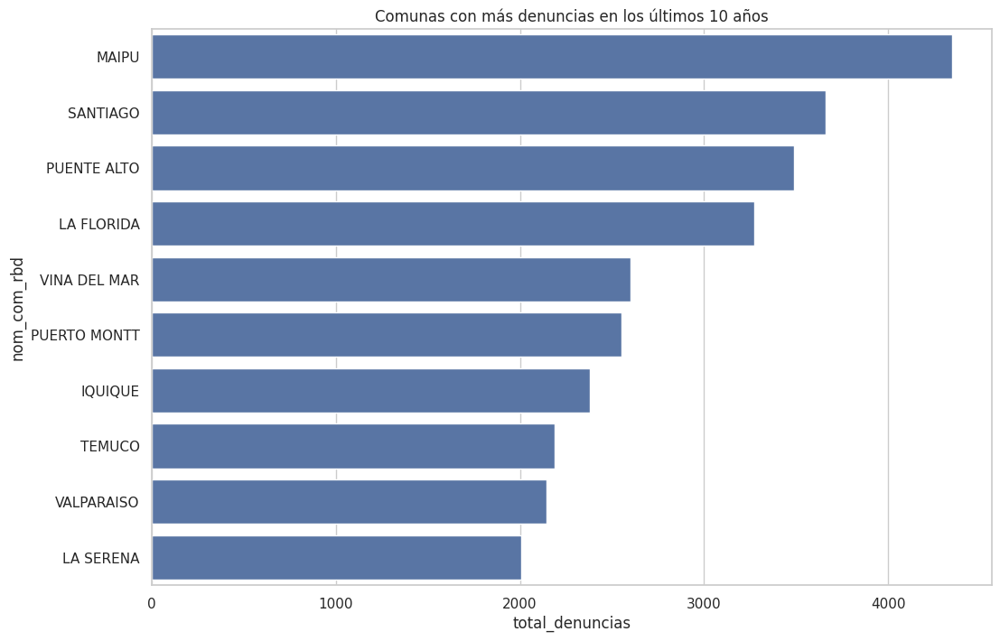

In [276]:
sns.barplot(top_comun_denuncias, x="total_denuncias", y="nom_com_rbd", orient="h")
plt.title("Comunas con más denuncias en los últimos 10 años")
plt.show()

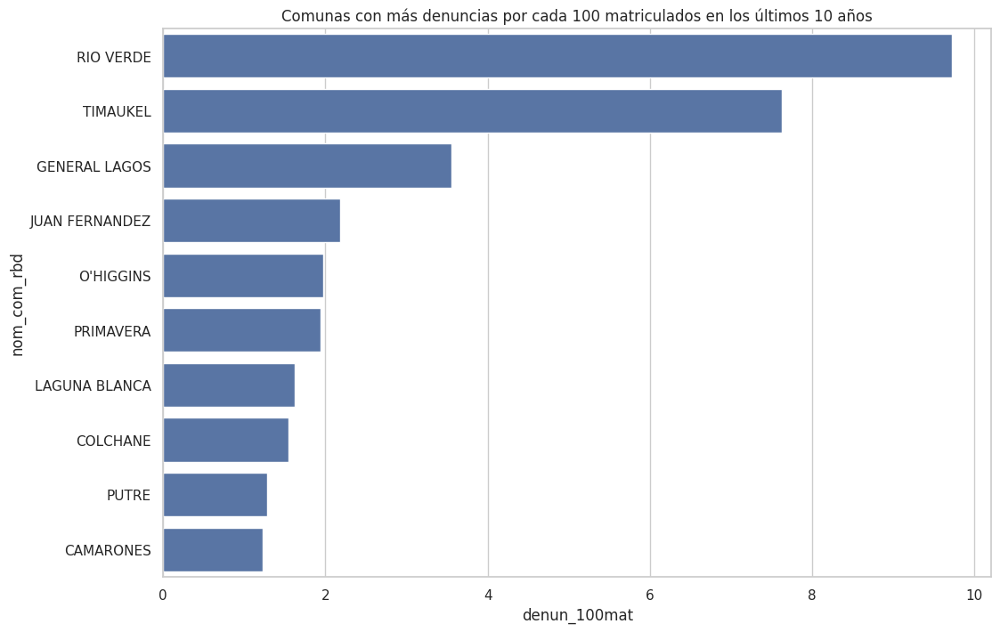

In [279]:
sns.barplot(
    estab_denun_mat_geo_agg.nlargest(10, "denun_100mat"),
    x="denun_100mat",
    y="nom_com_rbd",
    orient="h",
)
plt.title("Comunas con más denuncias por cada 100 matriculados en los últimos 10 años")
plt.show()

## Liceos con más denuncias

In [217]:
estab_denun_matr_agno_rbd = estab_denun_matr_agno_rbd.sort_values(["rbd", "agno"])

In [218]:
estab_denun_matr_agno_rbd.head()

,Unnamed: 0_x,agno,rbd,nom_rbd_x,cod_reg_rbd,cod_com_rbd,nom_com_rbd,cod_depe,cod_depe2,rural_rbd,...,mat_hom_6,mat_muj_6,mat_hom_7,mat_muj_7,mat_hom_8,mat_muj_8,mat_hom_tot,mat_muj_tot,mat_total,total_denuncias
0,0,2014,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,363,181,164,172,527,353,880,2
16593,16593,2015,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,351,179,222,211,573,390,963,2
27975,27975,2016,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,353,190,166,193,519,383,902,7
43965,43965,2017,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,309,180,142,171,451,351,802,2
59989,59989,2018,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,244,164,135,131,379,295,674,2


In [219]:
estab_denun_matr_agno_rbd["cambio"] = estab_denun_matr_agno_rbd.groupby("rbd")[
    "total_denuncias"
].diff()

In [290]:
rbd_tendencia = (
    estab_denun_matr_agno_rbd.groupby("rbd")["cambio"]
    .mean()
    .reset_index(name="Cambio Promedio")
)

In [221]:
agnos_con_denuncias = (
    estab_denun_matr_agno_rbd[estab_denun_matr_agno_rbd["total_denuncias"] > 10]
    .groupby("rbd")["agno"]
    .nunique()
    .reset_index(name="años con denuncias")
)

In [277]:
agnos_con_denuncias

,rbd,años con denuncias
0,52,2
1,60,1
2,78,1
3,106,1
4,110,2
...,...,...
500,40414,1
501,40422,2
502,40455,1
503,41124,1


In [291]:
rbd_tendencia = rbd_tendencia.merge(agnos_con_denuncias, on="rbd", how="left")

In [292]:
rbd_tendencia["años con denuncias"] = (
    rbd_tendencia["años con denuncias"].fillna(0).astype(int)
)

In [293]:
rbd_tendencia.nlargest(100, "años con denuncias")

,rbd,Cambio Promedio,años con denuncias
14224,25369,1.333333,9
14567,25749,-1.000000,9
7097,8627,-0.222222,8
13637,24685,1.222222,7
14073,25198,-1.444444,7
...,...,...,...
7697,9534,0.111111,2
8037,10030,1.333333,2
8350,10474,0.666667,2
8376,10505,0.777778,2


In [295]:
rbd_tendencia.nlargest(10, "Cambio Promedio")

,rbd,Cambio Promedio,años con denuncias
9426,12591,7.111111,3
14899,26117,5.777778,4
16282,41439,5.666667,1
7387,9071,5.333333,3
16537,41919,4.000000,0
6994,8485,3.444444,6
16142,41124,3.000000,1
16506,41859,3.000000,0
16624,42080,3.000000,0
8649,10851,2.555556,1


In [282]:
estab_denun_matr_agno_rbd["denun_100mat"] = (
    estab_denun_matr_agno_rbd["total_denuncias"]
    .divide(estab_denun_matr_agno_rbd["mat_total"] * 0.01)
    .replace(np.inf, 0)
)

In [289]:
estab_denun_matr_agno_rbd.groupby("rbd").agg(
    {
        "nom_rbd_x": "first",
        "total_denuncias": "sum",
        "mat_total": "sum",
        "denun_100mat": "mean",
    },
).reset_index()

,rbd,nom_rbd_x,total_denuncias,mat_total,denun_100mat
0,1,LICEO POLITECNICO ARICA,23,7608,0.281981
1,2,PARVULARIO LAS ESPIGUITAS,2,1889,0.104054
2,3,ESC. PEDRO VICENTE GUTIERREZ TORRES,0,4661,0.000000
3,4,LICEO OCTAVIO PALMA PEREZ,26,10775,0.236354
4,5,JOVINA NARANJO FERNANDEZ,26,8862,0.286982
...,...,...,...,...,...
16693,42195,SALA CUNA Y JARDIN INFANTIL ARBOLITO,0,0,NaN
16694,42196,SALA CUNA QUITRAL MONTESSORI,0,0,NaN
16695,42197,SALA CUNA NIDO ALEXANDER MONTESSORI,0,0,NaN
16696,42198,COLEGIO DE ADULTOS AMANECER,0,0,NaN


In [304]:
estab_denun_matr_agno_rbd.columns

Index(['agno', 'rbd', 'nom_rbd_x', 'cod_reg_rbd', 'cod_com_rbd', 'nom_com_rbd',
       'cod_depe', 'cod_depe2', 'rural_rbd', 'latitud', 'longitud',
       'convenio_pie', 'ori_religiosa', 'pago_matricula', 'pago_mensual',
       'mat_hom_tot', 'mat_muj_tot', 'mat_total', 'total_denuncias', 'cambio',
       'clasificacion_sep', 'n_prio', 'n_ben', 'mean_den_sep',
       'boolean_class_sep', 'denun_100mat'],
      dtype='object')

In [296]:
rbd_tendencia = rbd_tendencia.merge(
    estab_denun_matr_agno_rbd.groupby("rbd")
    .agg(
        {
            "nom_com_rbd": "first",
            "nom_rbd_x": "first",
            "total_denuncias": "sum",
            "mat_total": "sum",
            "denun_100mat": "mean",
        },
    )
    .reset_index(),
    on="rbd",
    how="left",
)

In [299]:
rbd_tendencia.nlargest(10, "denun_100mat")

,rbd,Cambio Promedio,años con denuncias,nom_rbd_x,total_denuncias,mat_total,denun_100mat
9788,13182,0.000000,0,ESC. DE LENGUAJE CREPONIA,6,225,71.726190
12673,20601,0.166667,0,COLEGIO TERRAVIDA,24,1704,58.090395
5723,6973,-0.111111,0,ESCUELA PARTICULAR SANTA JIMENA,1,2,50.000000
11428,16771,-0.111111,0,JARDIN INFANTIL RENACER,1,2,50.000000
10716,14886,0.000000,0,ESCUELA DE PARVULOS LILIPUT,3,28,42.857143
875,1073,0.000000,0,ESCUELA PARTICULAR EL RINCON,1,3,33.333333
12617,20473,-0.142857,0,COLEGIO SAN BENITO,21,56,32.142857
68,87,0.000000,0,ESCUELA ANCOLACANE,3,23,30.000000
2561,3189,0.111111,0,ESCUELA TERESA CONSUELO,5,49,23.539683
9287,12226,-0.111111,0,ESCUELA BASICA NÂ°1355 IRARRAZAVAL,11,310,21.225944


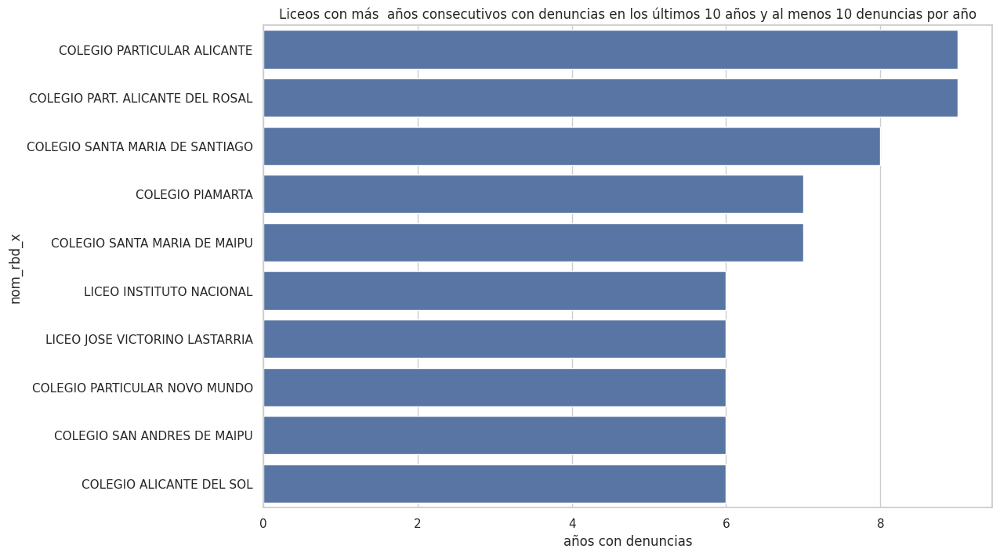

In [300]:
sns.barplot(
    rbd_tendencia.nlargest(10, "años con denuncias"),
    x="años con denuncias",
    y="nom_rbd_x",
    orient="h",
)
plt.title(
    "Liceos con más  años consecutivos con denuncias en los últimos 10 años y al menos 10 denuncias por año"
)
plt.show()

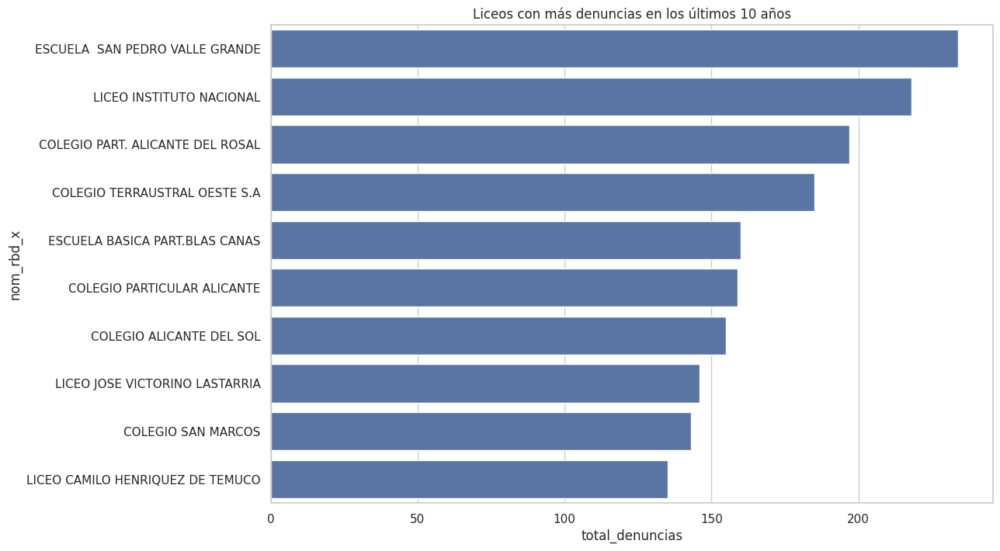

In [301]:
sns.barplot(
    rbd_tendencia.nlargest(10, "total_denuncias"),
    x="total_denuncias",
    y="nom_rbd_x",
    orient="h",
)
plt.title("Liceos con más denuncias en los últimos 10 años")
plt.show()

/workspaces/transparencia-chile-2024/.venv/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning:

Glyph 129 (\x81) missing from font(s) DejaVu Sans.



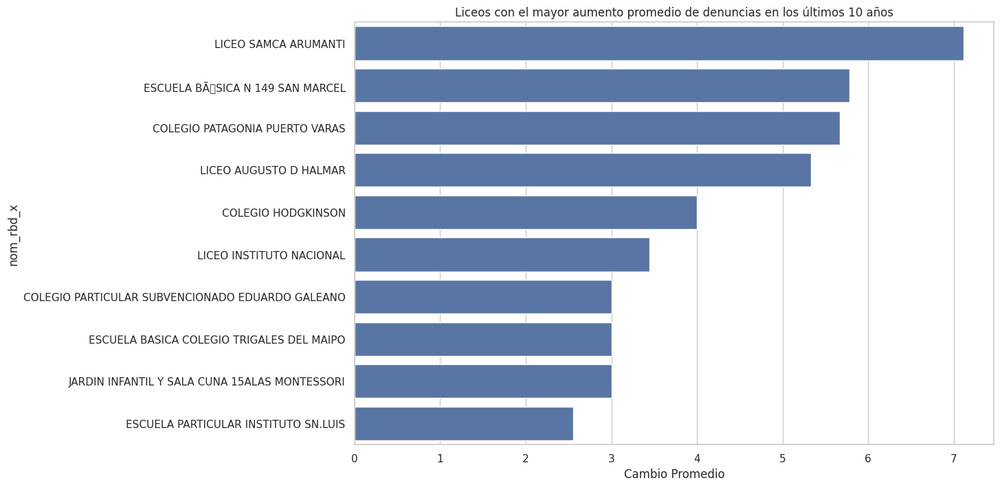

In [302]:
sns.barplot(
    rbd_tendencia.nlargest(10, "Cambio Promedio"),
    x="Cambio Promedio",
    y="nom_rbd_x",
    orient="h",
)
plt.title("Liceos con el mayor aumento promedio de denuncias en los últimos 10 años")
plt.show()

In [226]:
sep_ee.head(1)

,Unnamed: 0,agno,rbd,clasificacion_sep,n_prio,n_ben,convenio_sep,n_prio_ben,n_pref,n_pref_ben
0,0,2014,1,EMERGENTE,655,195,NaN,NaN,NaN,NaN


In [227]:
estab_denun_matr_agno_rbd = estab_denun_matr_agno_rbd.merge(
    sep_ee[["agno", "rbd", "clasificacion_sep", "n_prio", "n_ben"]],
    on=["agno", "rbd"],
    how="left",
)

In [228]:
estab_denun_matr_agno_rbd.columns

Index(['Unnamed: 0_x', 'agno', 'rbd', 'nom_rbd_x', 'cod_reg_rbd',
       'cod_com_rbd', 'nom_com_rbd', 'cod_depe', 'cod_depe2', 'rural_rbd',
       'latitud', 'longitud', 'convenio_pie', 'ori_religiosa',
       'pago_matricula', 'pago_mensual', 'Unnamed: 0_y', 'nom_rbd_y',
       'mat_hom_1', 'mat_muj_1', 'mat_hom_2', 'mat_muj_2', 'mat_hom_3',
       'mat_muj_3', 'mat_hom_4', 'mat_muj_4', 'mat_hom_5', 'mat_muj_5',
       'mat_hom_6', 'mat_muj_6', 'mat_hom_7', 'mat_muj_7', 'mat_hom_8',
       'mat_muj_8', 'mat_hom_tot', 'mat_muj_tot', 'mat_total',
       'total_denuncias', 'cambio', 'clasificacion_sep', 'n_prio', 'n_ben'],
      dtype='object')

In [229]:
estab_denun_matr_agno_rbd = estab_denun_matr_agno_rbd.drop(
    [
        "Unnamed: 0_x",
        "Unnamed: 0_y",
        "nom_rbd_y",
        "mat_hom_1",
        "mat_muj_1",
        "mat_hom_2",
        "mat_muj_2",
        "mat_hom_3",
        "mat_muj_3",
        "mat_hom_4",
        "mat_muj_4",
        "mat_hom_5",
        "mat_muj_5",
        "mat_hom_6",
        "mat_muj_6",
        "mat_hom_7",
        "mat_muj_7",
        "mat_hom_8",
        "mat_muj_8",
    ],
    axis=1,
)

In [230]:
from typing import Literal

from pandas._libs.missing import NAType


def convert_class_sep(  # noqa: PLR0911
    value: str | NAType,
) -> Literal["AUTONOMA", "EN RECUPERACION"] | NAType:
    """Change the class of sep."""
    if pd.isna(value):
        return pd.NA
    if isinstance(value, str):
        match value.strip():
            case "AUTONOMO":
                return "AUTONOMA"
            case "AUTÓNOMA":
                return "AUTONOMA"
            case "RECUPERACION":
                return "EN RECUPERACION"
            case "RECUPERACIÓN":
                return "EN RECUPERACION"
            case _:
                return value.strip()
    return pd.NA

In [231]:
estab_denun_matr_agno_rbd["clasificacion_sep"] = estab_denun_matr_agno_rbd[
    "clasificacion_sep"
].apply(convert_class_sep)

In [260]:
def convert_class_sep_binary(
    value: str | NAType,
) -> Literal["AUTONOMA", "EN RECUPERACION"] | NAType:
    """Change the class of sep."""
    if pd.isna(value):
        return pd.NA
    if isinstance(value, str):
        match value.strip():
            case "AUTONOMA":
                return "CON SEP"
            case "EN RECUPERACION":
                return "CON SEP"
            case "EMERGENTE":
                return "CON SEP"
            case _:
                return value.strip()
    return pd.NA

In [261]:
estab_denun_matr_agno_rbd["boolean_class_sep"] = estab_denun_matr_agno_rbd[
    "clasificacion_sep"
].apply(convert_class_sep_binary)

In [233]:
sep_mean_denun = estab_denun_matr_agno_rbd.groupby("clasificacion_sep")[
    "total_denuncias"
].mean()

In [259]:
sep_mean_denun

clasificacion_sep
AUTONOMA           1.686724
EMERGENTE          0.852769
EN RECUPERACION    1.130170
SIN SEP            0.766491
Name: total_denuncias, dtype: float64

<Axes: xlabel='clasificacion_sep'>

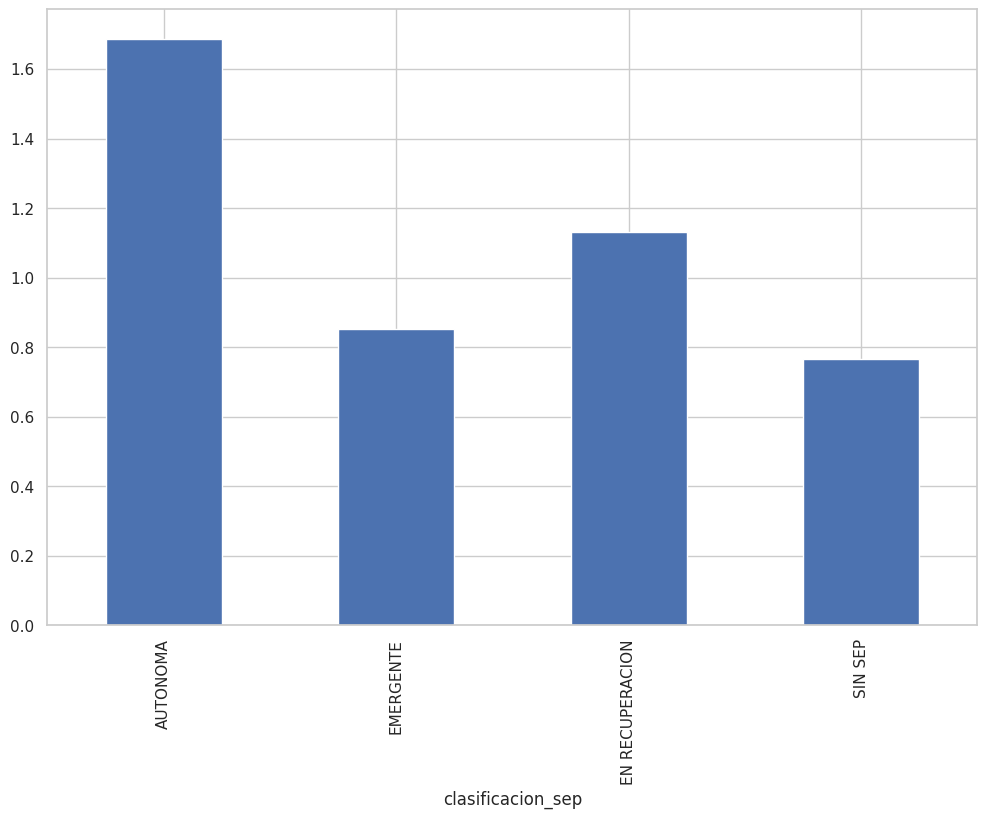

In [258]:
sep_mean_denun.plot(kind="bar")

In [262]:
boolsep_mean_denun = estab_denun_matr_agno_rbd.groupby("boolean_class_sep")[
    "total_denuncias"
].mean()

<Axes: title={'center': 'Promedio de denuncias según participación SEP'}, xlabel='boolean_class_sep'>

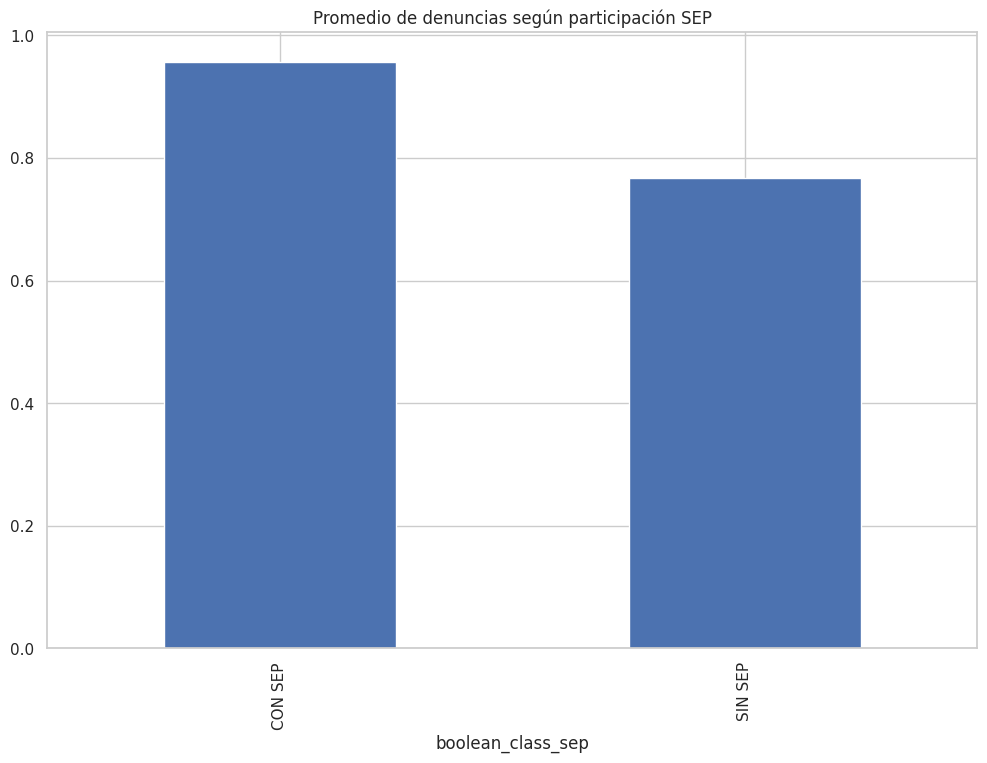

In [268]:
boolsep_mean_denun.plot(
    kind="bar", title="Promedio de denuncias según participación SEP"
)

In [234]:
estab_denun_matr_agno_rbd["mean_den_sep"] = estab_denun_matr_agno_rbd[
    "clasificacion_sep"
].map(sep_mean_denun)

In [248]:
df_denun_sep_forgraph = estab_denun_matr_agno_rbd[
    ["clasificacion_sep", "total_denuncias", "mean_den_sep"]
].dropna()

In [249]:
df_denun_sep_forgraph["clasificacion_sep"].unique().tolist()

['EMERGENTE', 'EN RECUPERACION', 'SIN SEP', 'AUTONOMA']

In [255]:
!uv pip install plotly

Resolved 3 packages in 423ms                                         
⠙ Preparing packages... (0/1)                                                   
⠙ Preparing packages... (0/1)----     0 B/18.17 MiB                     
⠙ Preparing packages... (0/1)---- 8.00 KiB/18.17 MiB                    
⠙ Preparing packages... (0/1)---- 16.00 KiB/18.17 MiB                   
⠙ Preparing packages... (0/1)---- 32.00 KiB/18.17 MiB                   
⠙ Preparing packages... (0/1)---- 48.00 KiB/18.17 MiB                   
⠙ Preparing packages... (0/1)---- 60.75 KiB/18.17 MiB                   
⠙ Preparing packages... (0/1)---- 76.75 KiB/18.17 MiB                   
⠙ Preparing packages... (0/1)---- 92.75 KiB/18.17 MiB                   
⠙ Preparing packages... (0/1)---- 108.75 KiB/18.17 MiB                  
⠙ Preparing packages... (0/1)---- 124.75 KiB/18.17 MiB                  
⠙ Preparing packages... (0/1)---- 140.75 KiB/18.17 MiB                  
⠙ Preparing packages... (0/1)---- 156.75 KiB/1

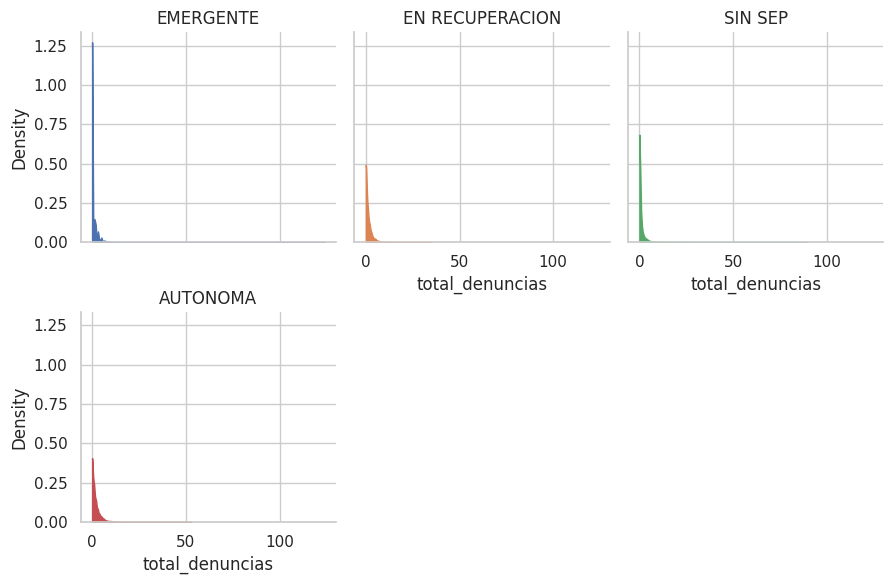

In [253]:
import matplotlib.pyplot as plt

# set seaborn whitegrid theme
sns.set_theme(style="whitegrid")

# using small multiple
# create a grid
g = sns.FacetGrid(
    df_denun_sep_forgraph, col="clasificacion_sep", hue="clasificacion_sep", col_wrap=3
)

# draw density plots
g = g.map(
    sns.kdeplot,
    "total_denuncias",
    cut=0,
    fill=True,
    common_norm=False,
    alpha=1,
    legend=False,
)

# control the title of each facet
g = g.set_titles("{col_name}")

# show the graph
plt.show()

In [265]:
df_denun_sep_forgraph.head(1)

,clasificacion_sep,total_denuncias,mean_den_sep
0,EMERGENTE,2,0.852769
